In [8]:
import os 
import networkx as nx
import matplotlib.pyplot as plt
import pandas as pd
from anytree import Node, RenderTree
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
import os 
import networkx as nx

import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap

from scipy.spatial import distance
import numpy as np

import pandas as pd
import seaborn as sns

import qml
from qml.math import cho_solve
from qml.kernels import gaussian_kernel


from scipy.stats import pearsonr, spearmanr


bohr_to_a = 0.529177


def scale_min_max(data, x):
    # print(data)
    # print(x)
    return (x - data.min())/(data.max() - data.min())

def scale_Z(data, x):
    # print(data)
    # print(x)
    return (x - data.mean())/(data.std())


def get_dist_matrix(atoms):
    #https://www.kaggle.com/code/rio114/coulomb-interaction-speed-up/notebook
    num_atoms = len(atoms)
    loc_tile = np.tile(atoms.T, (num_atoms,1,1))
    dist_mat = np.sqrt((loc_tile - loc_tile.T)**2).sum(axis=1)
    return dist_mat

def dihedral3(p):
    b = p[:-1] - p[1:]
    b[0] *= -1
    v = np.array( [np.cross(v,b[1]) for v in [b[0], b[2]] ] )
    # Normalize vectors
    v /= np.sqrt(np.einsum('...i,...i', v, v)).reshape(-1,1)
    return np.degrees(np.arccos( v[0].dot(v[1]) ))


def angle(p):
    ba = p[0] - p[1]
    bc = p[2] - p[1]
    cosine_angle = np.dot(ba, bc) / (np.linalg.norm(ba) * np.linalg.norm(bc))
    a3 = np.degrees(np.arccos(cosine_angle))
    return a3

def load_nc(path):
    #  load nuclear coordinates
    nc_lines = open(path).readlines()[6:12]
    ncs = np.array([[float(y)*bohr_to_a for y in x.split()[2:]] for x in nc_lines])
    return ncs




In [24]:
graph_pkl = "/home/unibas/boittier/fdcm_project/mdcms/methanol/H.obj" 
G = pd.read_pickle(graph_pkl)

def get_edge_weights(node):
    edges = G.edges(node)
    nodes = []
    weights = []
    for e in edges:
        nodes.append(e[1])
        weights.append(G.get_edge_data(*e)["weight"])
    return nodes, weights
        


In [11]:
RMSD_to_ref = pd.read_pickle("/home/unibas/boittier/fdcm_python/RMSD_to_ref.obj")

rmsd_to_ref = {}
for i, node in enumerate(G.nodes()):
    rmsd_to_ref[node] = RMSD_to_ref[i]
    

In [137]:
RMSD_to_ref = pd.read_pickle("/home/unibas/boittier/fdcm_python/RMSD_to_ref.obj")

def compare_distances(i, lcs_df, uptri_df, plot=False):
    comp_lcs = lcs_df.loc[i]
    comp_nc_uptri = uptri_df.loc[i]

    neighbour_lcs = []
    lcs_distances = []
    nc_uptri_distances = []

    edge_nodes, edge_weights = get_edge_weights(i)

    #  scan through edges
    for n, w in zip(edge_nodes, edge_weights):
        if n in list(lcs_df.index):
            tmp_lcs = lcs_df.loc[n]
            neighbour_lcs.append(tmp_lcs)

            lc_dist = np.sqrt(np.mean((comp_lcs - tmp_lcs)**2))
            lcs_distances.append(lc_dist)
            nc_uptri_dist = np.sqrt(np.mean((comp_nc_uptri - uptri_df.loc[n])**2))
            nc_uptri_distances.append(nc_uptri_dist)
            
    # print(f"mean distance: {np.mean(lcs_distances)}")

    if plot:

        plt.scatter(nc_uptri_distances, lcs_distances)
        plt.title("{}\n{}\n{}".format(i,pearsonr(nc_uptri_distances, lcs_distances), spearmanr(nc_uptri_distances, lcs_distances)))
        plt.xlabel("NC RMSD")
        plt.ylabel("LC RMSD")   
        plt.show()
        plt.clf()
        
        
    return pearsonr(nc_uptri_distances, lcs_distances)


def analysis(df_name):

    ref_pos = load_nc("/home/unibas/boittier/MDCM/examples/multi-conformer/ref/scan0.p.cube")
    ref_dm = get_dist_matrix(ref_pos)

    outdir = f"/data/unibas/boittier/{df_name}/output"
    pkl_path = f"/data/unibas/boittier/{df_name}/pickles"

    outfiles = os.listdir(outdir)
    print("# outfiles:", len(outfiles))


    initial_rmsds = {}
    final_rmsds = {}
    charge_rmsds = {}
    lcs = {}
    ncs = {}
    distM = {}
    ref_rmsd = {}
    flat_DMs = {}
    uptri_DMs = {}
    lcs_scaled = {}

    iu1 = np.triu_indices(6)


    for outfile in outfiles:
        index = int(outfile.split(".")[0])
        lines = open(os.path.join(outdir, outfile)).readlines()
        try:
            initial_rmsd = 0.0 #float(lines[5])
            final_rmsd = float([x for x in lines if x.__contains__("fun:")][0].split()[1])
            charge_rmsd = float([x for x in lines if x.__contains__("charge RMSD:")][0].split()[2]) 

            initial_rmsds[index] = initial_rmsd
            final_rmsds[index] = final_rmsd
            charge_rmsds[index] = charge_rmsd

            obj = f"{index}_clcl.obj"
            pkl = pd.read_pickle(os.path.join(pkl_path, obj))
            local = pkl[np.mod(np.arange(pkl.size)+1, 4) != 0]
            lcs[index] = local
            lcs_scaled[index] = scale_min_max(local, local)


            _path_ = f"/data/unibas/boittier/graphscan/methanol/t3/p{index}.p.cube"
            nc = load_nc(_path_)
            ncs[index] = nc
            dm = get_dist_matrix(nc)
            distM[index] = dm

            flat_dm = dm.flatten()
            flat_DMs[index] = flat_dm

            # reduce to only the upper triangle, no diagonals (zeros)
            uptri = dm[iu1]
            uptri_dm = uptri[uptri != 0]
            uptri_dm = scale_min_max(uptri_dm, uptri_dm)
            uptri_DMs[index] = uptri_dm

            ref_rmsd[index] = np.linalg.norm(dm-ref_dm)

        except Exception as e:
            print(outfile, e)




    df = pd.DataFrame({"rmsd_i": initial_rmsds, 
                      "rmsd_f": final_rmsds,
                      "chg_rmsd": charge_rmsds,
                      "ref_rmsd": ref_rmsd, 
                      "lcs": lcs,
                      "ncs": ncs,
                      "distM": distM,
                      "flatDM": flat_DMs,
                      "uptriDM": uptri_DMs})

    df["rmsd_dif"] = df["rmsd_i"] - df["rmsd_f"]

    df.to_pickle(f"data/{df_name}.obj")
    
    df.hist("rmsd_f")
    plt.show()
    
    lcs_df = pd.DataFrame(lcs).T
    rename = {i: f"q{i//3}ax{i%3}" for i in range(30)}
    lcs_df.rename(columns=rename, inplace=True)
    
    uptri_df = pd.DataFrame(uptri_DMs).T
    
    pearsons_r = []
    pearsons_p = []

    for i in list(G.nodes()):
        try:
            r, p = compare_distances(i, lcs_df, uptri_df)      
            pearsons_r.append(r)
            pearsons_p.append(p)

            
        except Exception as e:
            # print(i, e)
            pass
        
    plt.scatter(pearsons_r, pearsons_p, alpha=0.5)
        




# outfiles: 1811
1914.out list index out of range
2142.out list index out of range
2020.out list index out of range
2293.out list index out of range
2321.out list index out of range
2390.out list index out of range
2396.out list index out of range
2425.out list index out of range
2471.out list index out of range
2478.out list index out of range


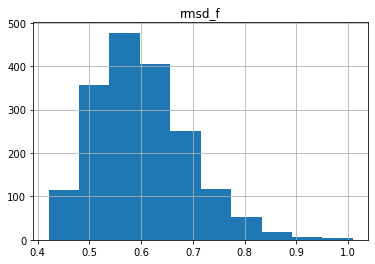

mean distance: 0.018434289919016744
mean distance: 0.01614220743769325
mean distance: 0.01696732745849889
mean distance: 0.024033130396715032
mean distance: 0.014343433334060013
mean distance: 0.01426978530826971
mean distance: 0.013991770472051523
mean distance: 0.018596592241019307
mean distance: 0.03209372974116146
mean distance: 0.014913374923927728
mean distance: 0.01696107719549929
mean distance: 0.01804053235847451
mean distance: 0.015639806057893994
mean distance: 0.015767310799719915
mean distance: 0.014087227172741149
mean distance: 0.01556963750312268
mean distance: 0.017677986832424226
mean distance: 0.01424414171360126
mean distance: 0.01482788525272878
mean distance: 0.024676175541380223
mean distance: 0.01789514356597918
mean distance: 0.014170029441217568
mean distance: 0.01922704778795743
mean distance: 0.0206258983425414
mean distance: 0.017600576032754875
mean distance: 0.01980497994405117
mean distance: 0.015394614608887393
mean distance: 0.015370725122356026
mean d

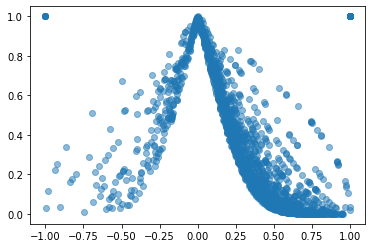

In [138]:
analysis("fmdcm_test")

# outfiles: 1811
1914.out list index out of range
2020.out list index out of range
2142.out list index out of range
2293.out list index out of range
2321.out list index out of range
2390.out list index out of range
2396.out list index out of range
2425.out list index out of range
2471.out list index out of range
2478.out list index out of range


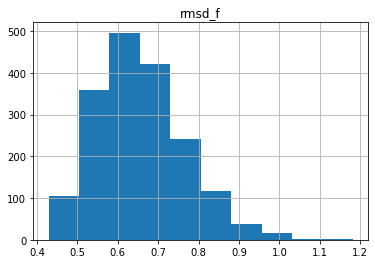

mean distance: 0.013193974896234485
mean distance: 0.011855249000428439
mean distance: 0.011063200393331333
mean distance: 0.017312257335444503
mean distance: 0.009804081603130418
mean distance: 0.009710339369159215
mean distance: 0.010006682122459129
mean distance: 0.012878394283945648
mean distance: 0.023937064271787985
mean distance: 0.010290156733648127
mean distance: 0.011865184554694343
mean distance: 0.013059041467676714
mean distance: 0.010868095770581033
mean distance: 0.011155530726198867
mean distance: 0.009896882461565441
mean distance: 0.010953169524225263
mean distance: 0.011984738704308547
mean distance: 0.010467969154460178
mean distance: 0.010429625827188458
mean distance: 0.018867917380165782
mean distance: 0.012612519542012552
mean distance: 0.009784699958966974
mean distance: 0.013430690044059179
mean distance: 0.014667440371187371
mean distance: 0.012476135892860618
mean distance: 0.014559446684190415
mean distance: 0.010575365264349497
mean distance: 0.01114730108

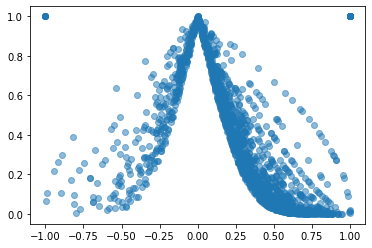

In [143]:
analysis("fmdcm_t1")

# outfiles: 1811
1914.out list index out of range
2020.out list index out of range
2142.out list index out of range
2293.out list index out of range
2321.out list index out of range
2390.out list index out of range
2396.out list index out of range
2425.out list index out of range
2471.out list index out of range
2478.out list index out of range


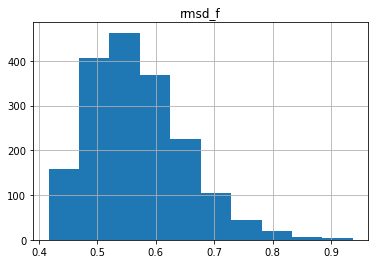

mean distance: 0.014854228921346795
mean distance: 0.013352381661095501
mean distance: 0.011605594367758062
mean distance: 0.02063691354523615
mean distance: 0.012465670110282738
mean distance: 0.012336521332986142
mean distance: 0.011671469696143397
mean distance: 0.01604225553695904
mean distance: 0.02268839268201336
mean distance: 0.012822589790844236
mean distance: 0.01453312496163888
mean distance: 0.015272641178749569
mean distance: 0.01211496717386943
mean distance: 0.01278729932837454
mean distance: 0.012046287827829539
mean distance: 0.013591804838292827
mean distance: 0.014235707099708268
mean distance: 0.012354667543067657
mean distance: 0.013433440316802065
mean distance: 0.020771864400837507
mean distance: 0.015747603077768173
mean distance: 0.012175706975294855
mean distance: 0.01560417934397509
mean distance: 0.016729685576929117
mean distance: 0.015325827802705921
mean distance: 0.0168814714362629
mean distance: 0.012606814065239981
mean distance: 0.012741158900195629
m

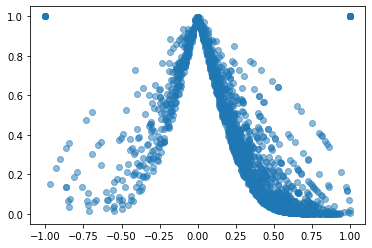

In [144]:
analysis("fmdcm_t2.med")

# outfiles: 1811
1914.out list index out of range
2020.out list index out of range
2142.out list index out of range
2293.out list index out of range
2321.out list index out of range
2390.out list index out of range
2396.out list index out of range
2425.out list index out of range
2471.out list index out of range
2478.out list index out of range


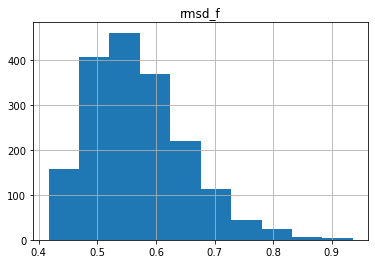

mean distance: 0.015106985961403925
mean distance: 0.013452640764077562
mean distance: 0.01141448735791339
mean distance: 0.020593306891246804
mean distance: 0.012501985932974169
mean distance: 0.012151548838976968
mean distance: 0.011809066733377057
mean distance: 0.01571523724031063
mean distance: 0.02257083568243544
mean distance: 0.012718810250282491
mean distance: 0.014105227349064437
mean distance: 0.015347408685923464
mean distance: 0.012250503092355286
mean distance: 0.012834832602168786
mean distance: 0.012037096784573337
mean distance: 0.013661010300971508
mean distance: 0.014409655743901682
mean distance: 0.012336425217544602
mean distance: 0.013322431857541592
mean distance: 0.02024643735457998
mean distance: 0.015568162243492544
mean distance: 0.012180846155183207
mean distance: 0.0156514482318689
mean distance: 0.016302239303177042
mean distance: 0.014979848541968677
mean distance: 0.01670546856303386
mean distance: 0.012523771800654691
mean distance: 0.012669491040341346

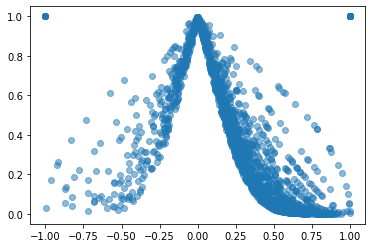

In [146]:
analysis("fmdcm_t2.mean")

# outfiles: 1811
1914.out list index out of range
2020.out list index out of range
2142.out list index out of range
2293.out list index out of range
2321.out list index out of range
2390.out list index out of range
2396.out list index out of range
2478.out list index out of range
2425.out list index out of range
2471.out list index out of range


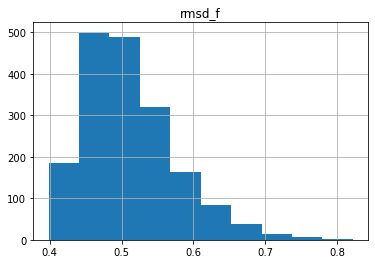

mean distance: 0.021162010360939853
mean distance: 0.018131812335201405
mean distance: 0.017335487443204643
mean distance: 0.02766907430082785
mean distance: 0.017598824392664466
mean distance: 0.01768826716631826
mean distance: 0.016534135539372354
mean distance: 0.02204089445465176
mean distance: 0.029822394904298305
mean distance: 0.018212727618059265
mean distance: 0.019869758927227747
mean distance: 0.02067018463049977
mean distance: 0.017461797791730845
mean distance: 0.018065923858213862
mean distance: 0.01693047858954423
mean distance: 0.01901510699310772
mean distance: 0.020659289774910845
mean distance: 0.016772419373027498
mean distance: 0.018594858494778665
mean distance: 0.027229775580719966
mean distance: 0.021207916630941816
mean distance: 0.017271326905174255
mean distance: 0.022082562926373207
mean distance: 0.022716200246805374
mean distance: 0.020490949939959428
mean distance: 0.022960415797174522
mean distance: 0.017849018068487862
mean distance: 0.01756974469704309

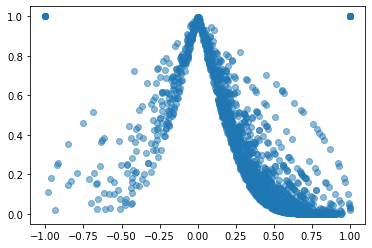

In [140]:
analysis("fmdcm_test_2")

In [133]:
# analysis("fmdcm_test_3")

# outfiles: 1811
1914.out list index out of range
2142.out list index out of range
2020.out list index out of range
2321.out list index out of range
2293.out list index out of range
2390.out list index out of range
2425.out list index out of range
2396.out list index out of range
2471.out list index out of range
2478.out list index out of range


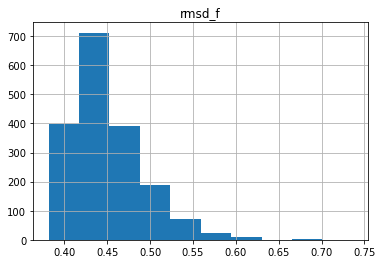

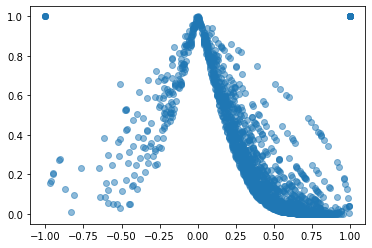

In [129]:
analysis("fmdcm_test_4")

# outfiles: 1811
2020.out list index out of range
1914.out list index out of range
2142.out list index out of range
2293.out list index out of range
2321.out list index out of range
2396.out list index out of range
2390.out list index out of range
2425.out list index out of range
2471.out list index out of range
2478.out list index out of range


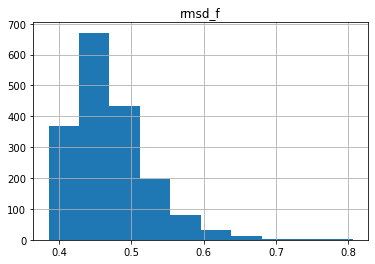

mean distance: 0.023180725950940936
mean distance: 0.01991646130710836
mean distance: 0.01847294343728495
mean distance: 0.030088527647858222
mean distance: 0.019965237554884364
mean distance: 0.02093886877228277
mean distance: 0.018514113675513116
mean distance: 0.025179626119747726
mean distance: 0.028053492328199345
mean distance: 0.021166316780736785
mean distance: 0.022431245973930557
mean distance: 0.022470573801566255
mean distance: 0.01945812493331068
mean distance: 0.0201246230361665
mean distance: 0.019211130366333623
mean distance: 0.021394713772390352
mean distance: 0.023136961395290104
mean distance: 0.019154760024461988
mean distance: 0.02137241339582492
mean distance: 0.030233940874883885
mean distance: 0.02408897645278047
mean distance: 0.01987554873538703
mean distance: 0.024531079353244722
mean distance: 0.026064302581702108
mean distance: 0.02277826696537748
mean distance: 0.0274326391632683
mean distance: 0.020865104677803156
mean distance: 0.019895428291909094
mean

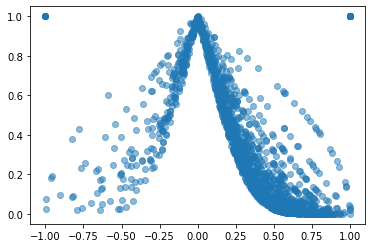

In [141]:
analysis("fmdcm_test_4.med")

# outfiles: 1811
1914.out list index out of range
2142.out list index out of range
2020.out list index out of range
2321.out list index out of range
2425.out list index out of range
2396.out list index out of range
2293.out list index out of range
2390.out list index out of range
2471.out list index out of range
2478.out list index out of range


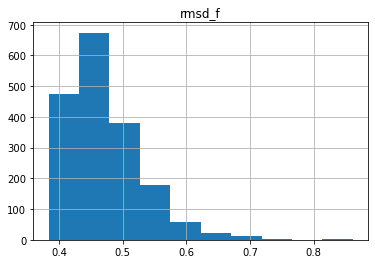

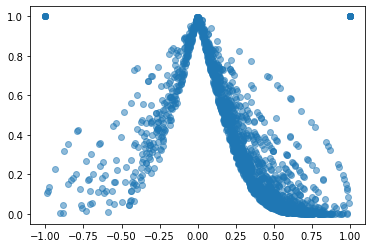

In [135]:
analysis("fmdcm_test_5")

In [91]:
lcs_df = pd.DataFrame(lcs).T
rename = {i: f"q{i//3}ax{i%3}" for i in range(30)}
lcs_df.rename(columns=rename, inplace=True)
lcs_df

,q0ax0,q0ax1,q0ax2,q1ax0,q1ax1,q1ax2,q2ax0,q2ax1,q2ax2,q3ax0,...,q6ax2,q7ax0,q7ax1,q7ax2,q8ax0,q8ax1,q8ax2,q9ax0,q9ax1,q9ax2
1001,0.515690,0.000451,0.048764,0.040815,0.002448,0.089929,0.460740,-0.326936,0.008848,0.467235,...,0.033931,0.107271,-0.039271,0.219718,-0.056209,-0.025898,0.090251,-0.201794,0.065554,0.155582
1000,0.518910,-0.001185,0.045473,0.036802,-0.008425,0.119788,0.463417,-0.317712,-0.005483,0.444983,...,0.041479,0.132738,-0.060602,0.254336,-0.074117,-0.036144,0.092335,-0.144860,0.095916,0.103331
1004,0.519357,-0.000386,0.050557,0.024584,-0.008215,0.089771,0.463802,-0.341556,-0.001477,0.455417,...,0.030005,0.147494,-0.023780,0.244659,-0.086410,-0.042762,0.113464,-0.198389,0.101305,0.113052
1005,0.511434,-0.000749,0.051027,0.016104,-0.015398,0.071165,0.469673,-0.363794,0.004520,0.459478,...,-0.049313,0.074929,-0.031863,0.179194,-0.079814,0.000328,0.189262,-0.221348,0.068314,0.178818
1006,0.519296,0.001026,0.052827,-0.009954,-0.019629,0.071281,0.437525,-0.367281,-0.002125,0.464233,...,-0.070589,0.064245,-0.057118,0.179867,-0.097333,0.014656,0.232062,-0.192758,0.075463,0.158941
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
914,0.519786,-0.001015,0.051792,0.021308,-0.007844,0.078625,0.462182,-0.340390,-0.002367,0.447576,...,-0.005713,0.121001,-0.054566,0.199001,-0.087895,-0.034550,0.158822,-0.180720,0.091742,0.143568
915,0.519485,0.000412,0.045562,-0.001578,-0.008435,0.113276,0.455768,-0.348487,-0.000688,0.442306,...,0.005422,0.027666,-0.058763,0.111007,-0.022551,-0.040788,0.100044,-0.271551,0.044596,0.266425
916,0.517765,0.000194,0.054458,0.001099,0.017853,0.065584,0.462381,-0.368606,-0.005468,0.464626,...,-0.057284,0.121675,-0.007894,0.254338,-0.057900,-0.048065,0.111771,-0.239314,0.078817,0.207085
917,0.519510,0.000875,0.049629,-0.001824,0.018748,0.084185,0.460774,-0.352765,0.007537,0.446377,...,-0.015011,0.095304,-0.120162,0.149029,-0.109518,-0.036317,0.139773,-0.178764,0.051981,0.215331


In [92]:
uptri_df = pd.DataFrame(uptri_DMs).T
uptri_df

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
1001,0.056858,0.0,0.689989,0.523200,0.627354,0.418212,0.164532,0.104988,0.093696,0.583685,1.000000,0.736446,0.357593,0.299785,0.446251
1000,0.059163,0.0,0.629436,0.556109,0.651140,0.405136,0.127678,0.150973,0.148086,0.738199,1.000000,0.526981,0.443001,0.340585,0.389438
1004,0.086339,0.0,0.721862,0.537112,0.738398,0.445498,0.172635,0.091614,0.189466,0.687639,1.000000,0.635417,0.504865,0.222979,0.483783
1005,0.077935,0.0,0.533889,0.562519,0.561333,0.403109,0.114980,0.159409,0.061717,0.907845,1.000000,0.439819,0.235978,0.445469,0.336238
1006,0.115590,0.0,0.724546,0.734137,0.565613,0.450592,0.174569,0.187792,0.115021,0.615093,0.734536,1.000000,0.314404,0.470412,0.443773
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
914,0.093872,0.0,0.754172,0.561553,0.758285,0.461409,0.186205,0.097596,0.192866,0.679825,1.000000,0.776727,0.424356,0.245788,0.442681
915,0.058846,0.0,0.560013,0.729187,0.729491,0.457149,0.098944,0.180977,0.177359,1.000000,0.697104,0.590827,0.486224,0.445755,0.166875
916,0.115247,0.0,0.652092,0.597712,0.559296,0.418526,0.134557,0.179186,0.048117,0.477529,1.000000,0.815209,0.302281,0.414381,0.462955
917,0.065892,0.0,0.552763,0.577092,0.635162,0.400543,0.152219,0.063962,0.130790,1.000000,0.780350,0.508628,0.360743,0.286765,0.412486


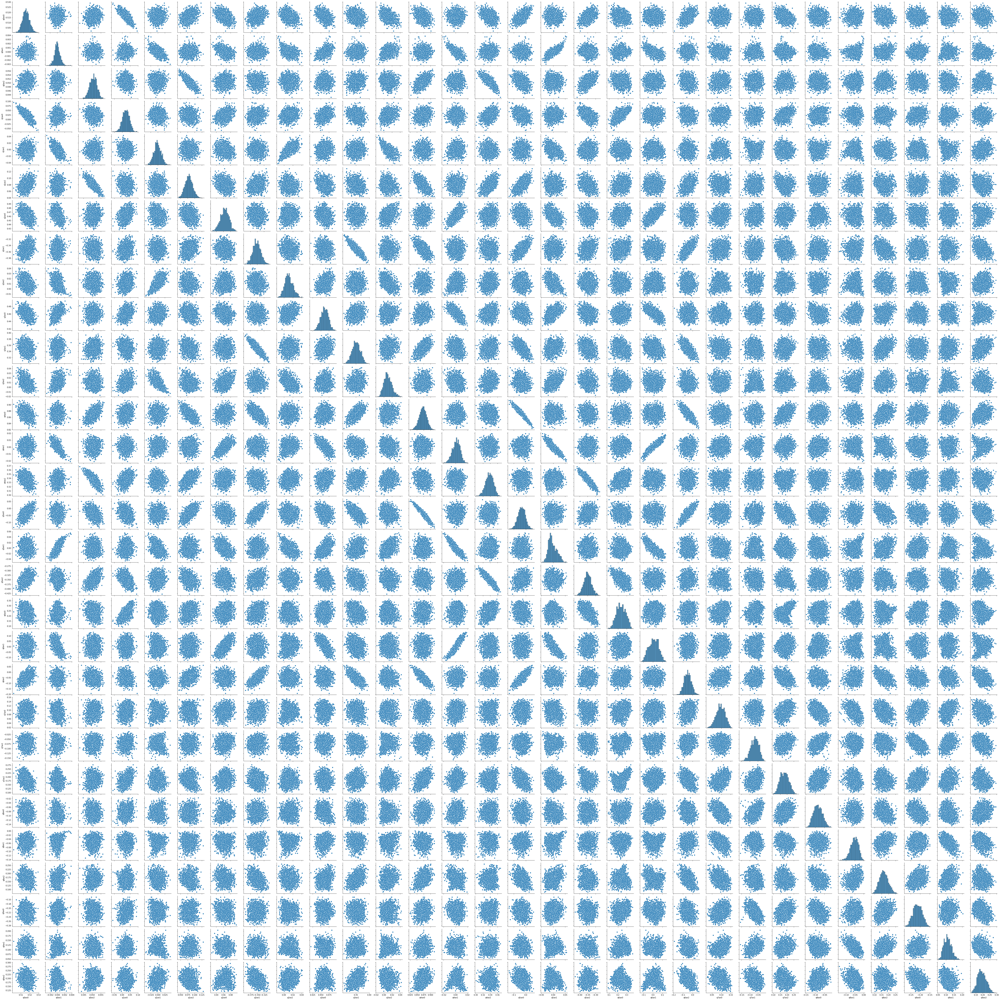

In [121]:
# test = uptri_df.join(lcs_df["q0ax0"])
sns.pairplot(lcs_df)

<AxesSubplot:>

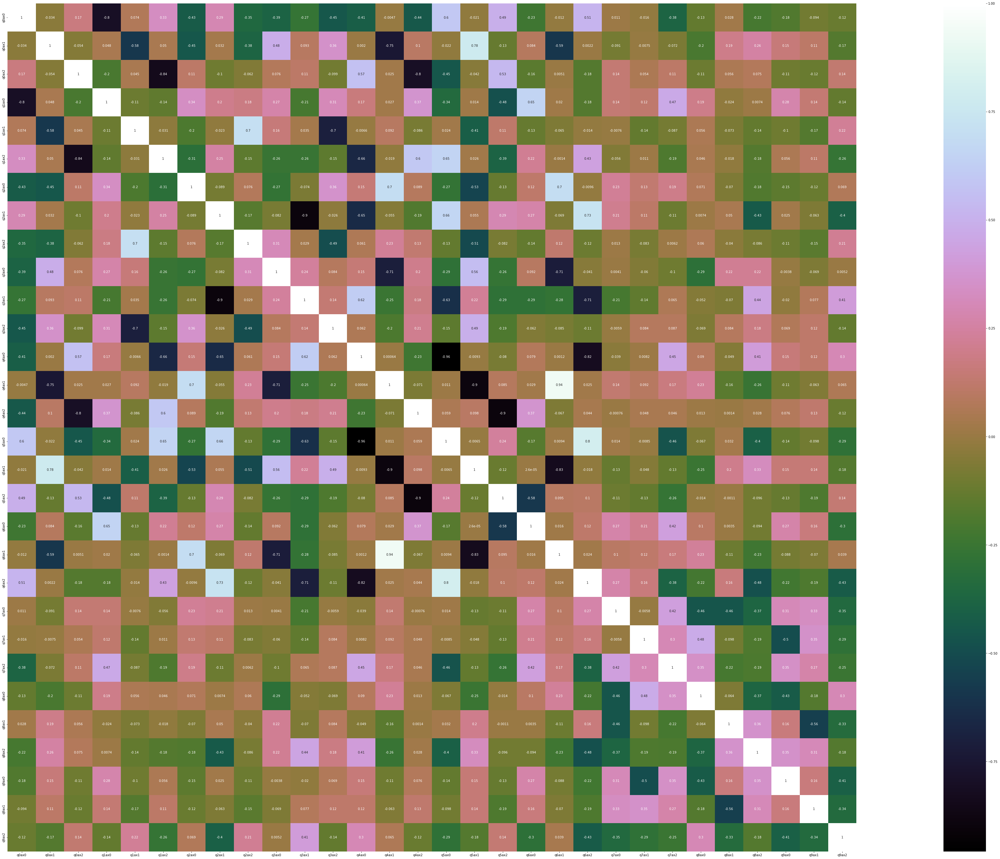

In [20]:
corr_mat=lcs_df.corr(method='pearson')
plt.figure(figsize=(100,50))
sns.heatmap(corr_mat,vmax=1,square=True,annot=True,cmap='cubehelix')

In [21]:
lcs_df

,q0ax0,q0ax1,q0ax2,q1ax0,q1ax1,q1ax2,q2ax0,q2ax1,q2ax2,q3ax0,...,q6ax2,q7ax0,q7ax1,q7ax2,q8ax0,q8ax1,q8ax2,q9ax0,q9ax1,q9ax2
2495,0.509437,0.000701,0.049597,0.047098,-0.016664,0.077648,0.462187,-0.382637,0.005532,0.463512,...,-0.156096,0.034624,-0.081757,0.173326,-0.073533,-0.036152,0.251350,-0.204302,0.122607,0.228030
1000,0.516884,-0.000126,0.044791,0.052406,-0.009331,0.120294,0.466638,-0.315531,0.003948,0.442514,...,0.018675,0.120041,-0.067510,0.213125,-0.073373,-0.049576,0.111202,-0.179122,0.110138,0.137534
1001,0.515447,0.000169,0.048584,0.049244,0.003885,0.093352,0.458572,-0.321927,0.014100,0.468166,...,0.013429,0.103779,-0.056539,0.194015,-0.060761,-0.043930,0.112701,-0.210861,0.091057,0.168446
101,0.514246,-0.000050,0.051110,0.036767,-0.008366,0.078315,0.467013,-0.364232,0.007233,0.454555,...,-0.079889,0.122802,-0.055118,0.239777,-0.079943,-0.069429,0.161799,-0.195668,0.134951,0.173283
1021,0.523821,-0.000170,0.050664,-0.023335,0.001808,0.090399,0.464508,-0.335739,0.014882,0.447995,...,0.022397,0.110178,-0.055784,0.175216,-0.074975,-0.051488,0.097496,-0.245777,0.088816,0.170500
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
889,0.507641,-0.000286,0.052375,0.055467,0.002377,0.051089,0.477961,-0.373364,0.025514,0.469238,...,-0.111556,0.115980,-0.093249,0.214182,-0.096993,-0.071098,0.164049,-0.201998,0.104343,0.224689
901,0.520634,-0.000616,0.052942,-0.018757,0.001494,0.070415,0.463140,-0.355180,0.008249,0.455014,...,-0.029584,0.076163,-0.045938,0.143767,-0.085912,-0.036130,0.190210,-0.252265,0.106448,0.170296
895,0.516509,-0.000259,0.052457,0.023390,-0.019417,0.067865,0.457748,-0.338957,0.003338,0.452391,...,-0.097550,0.071701,-0.138449,0.180714,-0.050178,-0.072684,0.170209,-0.241755,0.105052,0.216372
903,0.505195,-0.001337,0.044680,0.089430,0.006530,0.094914,0.479480,-0.347461,0.028195,0.449375,...,-0.110824,0.066602,-0.045513,0.212289,-0.044737,-0.064115,0.198985,-0.202981,0.148726,0.176041
